# Running batch correction (with `harmony`) for the mouse and human atlas datasets

In [1]:
import scanpy as sc
import scanpy.external as sce
import pandas as pd

import random
import gc
import os
import seaborn as sns

In [2]:
WORKDIR="/workdir/dwm269/scMuscle2"
os.chdir(WORKDIR)

In [3]:
gc.enable()

In [4]:
NCORES=16
sc.settings.n_jobs = NCORES

In [5]:
from scripts.py.scantils import *
# from scripts.py.scanplots import *

## Mouse

In [23]:
mouse = sc.read_h5ad("data/atlas/mus_musculus_pp.h5ad")
mouse.shape

(1538623, 433)

In [17]:
sce.pp.harmony_integrate(
    mouse,
    basis="X_pca",
    adjusted_basis="X_pca_harmony",
    key="GSM.accession"
)

2023-04-22 19:48:17,121 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-04-22 19:58:19,404 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-04-22 19:58:42,421 - harmonypy - INFO - Iteration 1 of 10
2023-04-22 21:40:16,838 - harmonypy - INFO - Iteration 2 of 10
2023-04-22 23:21:44,118 - harmonypy - INFO - Converged after 2 iterations


In [18]:
reorder_reduction(
    mouse,
    reduction="X_pca_harmony",
    verbose=True
)

Reduction variance by dimension:
[5.5562487, 6.414771, 0.6495009, 2.5406086, 3.8363593, 3.3479037, 3.2393885, 2.5724998, 2.6540804, 2.0915632, 2.2638216, 1.8431208, 1.0545393, 1.3283968, 1.2478734, 1.4488344, 1.1252815, 1.0210147, 1.0911748, 0.9326929, 0.9974193, 0.85812396, 0.8812092, 0.8563103, 0.660331, 0.79290104, 0.7797296, 0.7222814, 0.62506807, 0.79446435, 0.7232968, 0.7588097, 0.6556831, 0.71162975, 0.70749545, 0.72796327, 0.6839139, 0.69474906, 0.69310564, 0.6776395, 0.6243009, 0.6750553, 0.60313845, 0.66909146, 0.6571619, 0.6532034, 0.65666544, 0.64762366, 0.65469766, 0.6790604]


In [24]:
sc.pp.neighbors(
    mouse,
    n_neighbors=50,
    n_pcs=npcs(mouse, reduction="X_pca_harmony"),
    use_rep="X_pca_harmony",
    key_added="harmony_knn"
)
gc.collect()

26997

In [29]:
sc.tl.leiden(
    mouse,
    resolution=1.2,
    neighbors_key="harmony_knn", 
    key_added=f"harmony_{1.2}"
)

In [30]:
sc.tl.umap(
    mouse,
    neighbors_key="harmony_knn"
)

/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


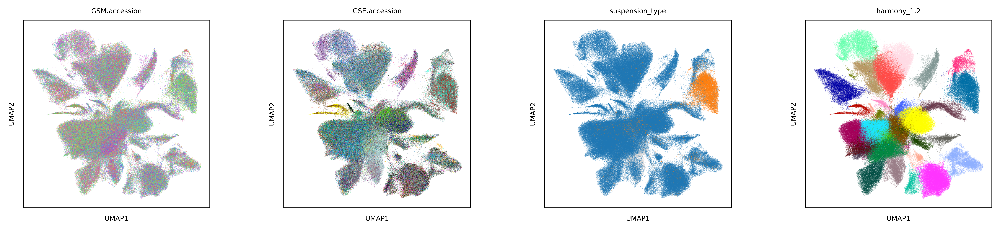

In [24]:
sc.set_figure_params(
    figsize=(3,3),
    fontsize=6,
    transparent=False,
    dpi=300
)

sc.pl.umap(
    mouse,
    legend_loc=None, 
    color=["GSM.accession","GSE.accession","suspension_type","harmony_1.2"],
    save="mouse_gsm_umap_harmony.png"
)

In [39]:
mouse.write_h5ad(
    "data/atlas/mus_musculus_pp_harmony.h5ad"
)

In [40]:
# if os.path.exists("data/atlas/mus_musculus_pp_harmony.h5ad"):
#     del mouse

## Human

Load human data...

In [18]:
human = sc.read_h5ad("data/atlas/homo_sapiens_pp.h5ad")
human.shape

(1049414, 488)

In [7]:
sce.pp.harmony_integrate(
    human,
    basis="X_pca",
    adjusted_basis="X_pca_harmony",
    key="GSM.accession"
)

2023-04-24 09:04:29,522 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-04-24 09:11:01,748 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-04-24 09:11:12,730 - harmonypy - INFO - Iteration 1 of 10
2023-04-24 09:39:40,994 - harmonypy - INFO - Iteration 2 of 10
2023-04-24 10:10:55,931 - harmonypy - INFO - Converged after 2 iterations


In [8]:
reorder_reduction(
    human,
    reduction="X_pca_harmony",
    verbose=True
)

Reduction variance by dimension:
[4.5728507, 2.9964938, 3.75502, 1.4264804, 1.8442173, 1.6580968, 1.61128, 1.7941619, 1.1259828, 0.9756478, 1.1067871, 0.9350363, 0.6911761, 0.82654154, 0.8394415, 0.98065096, 0.62517077, 0.6788576, 0.673627, 0.6183652, 0.6884002, 0.63494086, 0.73718196, 0.6900679, 0.76254386, 0.73838305, 0.6915923, 0.6497595, 0.67380935, 0.57162917, 0.6348469, 0.49901098, 0.6483564, 0.68289495, 0.6382479, 0.62310725, 0.6929653, 0.62841976, 0.6591722, 0.628483, 0.6458815, 0.6458558, 0.62786365, 0.6448101, 0.62418115, 0.6497069, 0.6393666, 0.6348044, 0.6768184, 0.6426452]


In [10]:
sc.pp.neighbors(
    human,
    n_neighbors=50,
    n_pcs=npcs(human, reduction="X_pca_harmony"),
    use_rep="X_pca_harmony",
    key_added="harmony_knn"
)
gc.collect()

23586

In [11]:
sc.tl.leiden(
    human,
    resolution=1.2,
    neighbors_key="harmony_knn", 
    key_added=f"harmony_{1.2}"
)
gc.collect()

0

In [12]:
sc.tl.umap(
    human,
    neighbors_key="harmony_knn"
)
gc.collect()

30079

In [13]:
palette=sns.color_palette(
    "hls", 
    len(human.obs["GSM.accession"].unique())
)
random.shuffle(palette)
human.uns['GSM.accession_colors'] =  ["#{:02x}{:02x}{:02x}".format(int(r * 255), int(g * 255), int(b * 255)) for r, g, b in palette]

/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


/home/dwm269/miniconda3/envs/scm2/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


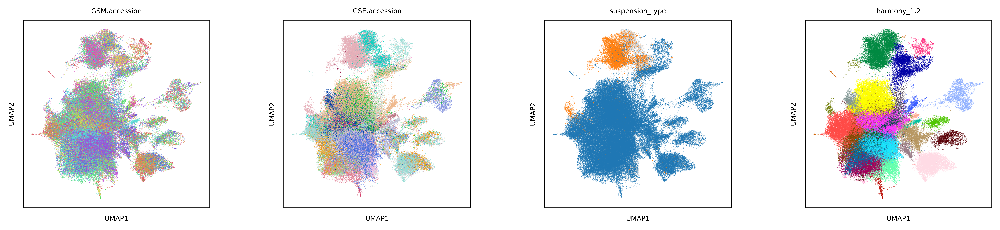

In [20]:
sc.set_figure_params(
    figsize=(3,3),
    fontsize=6,
    transparent=False,
    dpi=300
)

sc.pl.umap(
    human,
    legend_loc=None, 
    color=["GSM.accession","GSE.accession","suspension_type","harmony_1.2"],
    save="human_gsm_umap_harmony.png"
)

In [15]:
human.write_h5ad(
    "data/atlas/homo_sapiens_pp_harmony.h5ad"
)

In [16]:
# if os.path.exists("data/atlas/homo_sapiens_pp_harmony.h5ad"):
#     del human